# Whale and Dolphin Identification

# Importing Libraries

In [1]:
import os

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns


from PIL import Image
from tqdm import tqdm
import random as rnd

%matplotlib inline

## Loading Dataset


In [2]:
train_df = pd.read_csv('../happy-whale-and-dolphin/train.csv')
train_df['path'] = '../happy-whale-and-dolphin/train_images/' + train_df['image']

pred_df = pd.read_csv('../happy-whale-and-dolphin/sample_submission.csv')
pred_df['path'] = '../happy-whale-and-dolphin/test_images/' + pred_df['image']

In [3]:
len(train_df)

51033

In [5]:
len(pred_df)

27956

In [5]:
print('Train samples count: ', len(train_df))
train_df.columns

Train samples count:  51033


Index(['image', 'species', 'individual_id', 'path'], dtype='object')

In [6]:
print('Species Count: ',len(train_df['species'].value_counts()))
set(train_df.species)

Species Count:  30


{'beluga',
 'blue_whale',
 'bottlenose_dolphin',
 'bottlenose_dolpin',
 'brydes_whale',
 'commersons_dolphin',
 'common_dolphin',
 'cuviers_beaked_whale',
 'dusky_dolphin',
 'false_killer_whale',
 'fin_whale',
 'frasiers_dolphin',
 'globis',
 'gray_whale',
 'humpback_whale',
 'kiler_whale',
 'killer_whale',
 'long_finned_pilot_whale',
 'melon_headed_whale',
 'minke_whale',
 'pantropic_spotted_dolphin',
 'pilot_whale',
 'pygmy_killer_whale',
 'rough_toothed_dolphin',
 'sei_whale',
 'short_finned_pilot_whale',
 'southern_right_whale',
 'spinner_dolphin',
 'spotted_dolphin',
 'white_sided_dolphin'}

In [7]:
train_df['species'].value_counts()

bottlenose_dolphin           9664
beluga                       7443
humpback_whale               7392
blue_whale                   4830
false_killer_whale           3326
dusky_dolphin                3139
spinner_dolphin              1700
melon_headed_whale           1689
minke_whale                  1608
killer_whale                 1493
fin_whale                    1324
gray_whale                   1123
bottlenose_dolpin            1117
kiler_whale                   962
southern_right_whale          866
spotted_dolphin               490
sei_whale                     428
short_finned_pilot_whale      367
common_dolphin                347
cuviers_beaked_whale          341
pilot_whale                   262
long_finned_pilot_whale       238
white_sided_dolphin           229
brydes_whale                  154
pantropic_spotted_dolphin     145
globis                        116
commersons_dolphin             90
pygmy_killer_whale             76
rough_toothed_dolphin          60
frasiers_dolph

# Data Cleaning
### Fixing Duplicate Labels
* `bottlenose_dolpin` -> `bottlenose_dolphin`
* `kiler_whale` -> `killer_whale`
* `beluga` -> `beluga_whale`

### Changing Label due to extreme similarities
* `globis` & `pilot_whale` -> `short_finned_pilot_whale`

In [8]:
print('Before fixing duplicate labels : ')
print("Number of unique species : ", train_df['species'].nunique())

train_df['species'].replace({
    'bottlenose_dolpin' : 'bottlenose_dolphin',
    'kiler_whale' : 'killer_whale',
    'beluga' : 'beluga_whale',
    'globis' : 'short_finned_pilot_whale',
    'pilot_whale' : 'short_finned_pilot_whale'
},inplace =True)

print('\nAfter fixing duplicate labels : ')
print("Number of unique species : ", train_df['species'].nunique())


train_df['class'] = train_df['species'].apply(lambda x: x.split('_')[-1])
train_df.head()

Before fixing duplicate labels : 
Number of unique species :  30

After fixing duplicate labels : 
Number of unique species :  26


,image,species,individual_id,path,class
0,00021adfb725ed.jpg,melon_headed_whale,cadddb1636b9,../happy-whale-and-dolphin/train_images/00021a...,whale
1,000562241d384d.jpg,humpback_whale,1a71fbb72250,../happy-whale-and-dolphin/train_images/000562...,whale
2,0007c33415ce37.jpg,false_killer_whale,60008f293a2b,../happy-whale-and-dolphin/train_images/0007c3...,whale
3,0007d9bca26a99.jpg,bottlenose_dolphin,4b00fe572063,../happy-whale-and-dolphin/train_images/0007d9...,dolphin
4,00087baf5cef7a.jpg,humpback_whale,8e5253662392,../happy-whale-and-dolphin/train_images/00087b...,whale


## Checking missing data

In [9]:
train_df.isna().sum()

image            0
species          0
individual_id    0
path             0
class            0
dtype: int64

## Check for missing image

In [10]:
len(os.listdir('../happy-whale-and-dolphin/train_images'))

51033

In [11]:
len(train_df.path)

51033

# Visualization

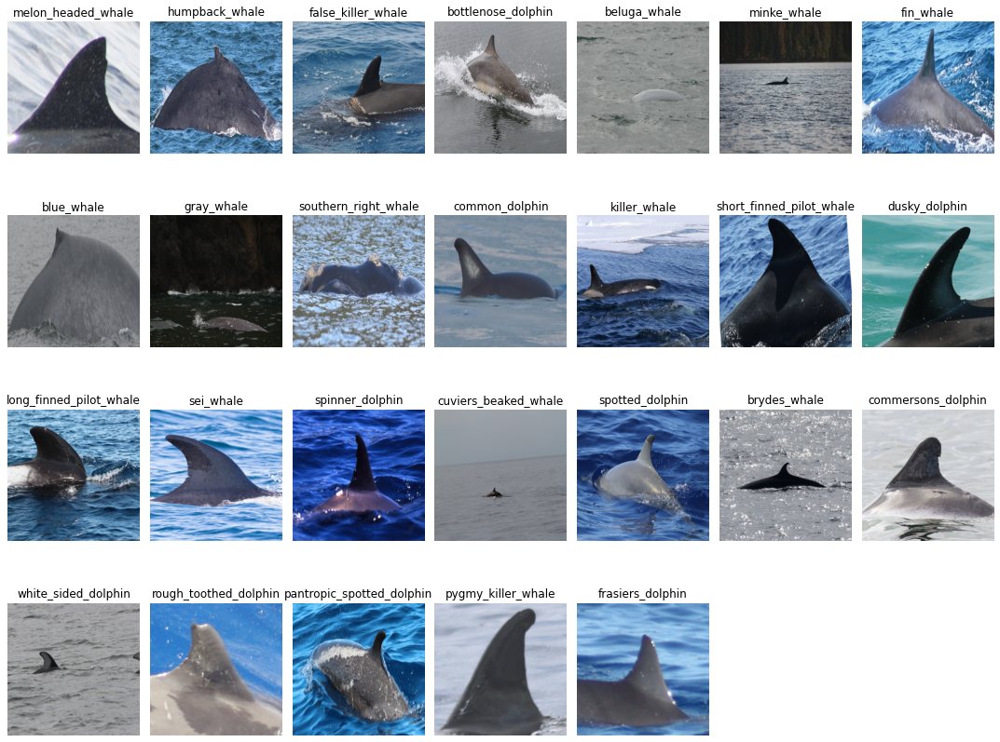

In [12]:
plt.figure(figsize = (15,12))
for idx,i in enumerate(train_df.species.unique()):
    plt.subplot(4,7,idx+1)
    df = train_df[train_df['species'] ==i].reset_index(drop = True)
    image_path = df.loc[rnd.randint(0, len(df))-1,'path']
    img = Image.open(image_path)
    img = img.resize((224,224))
    plt.imshow(img)
    plt.axis('off')
    plt.title(i)
plt.tight_layout()
plt.show()

In [13]:
def plot_species(df,species_name):
    plt.figure(figsize = (12,12))
    species_df = df[df['species'] ==species_name].reset_index(drop = True)
    plt.suptitle(species_name)
    for idx,i in enumerate(np.random.choice(species_df['path'],32)):
        plt.subplot(8,8,idx+1)
        image_path = i
        img = Image.open(image_path)
        img = img.resize((224,224))
        plt.imshow(img)
        plt.axis('off')
    plt.tight_layout()
    plt.show()


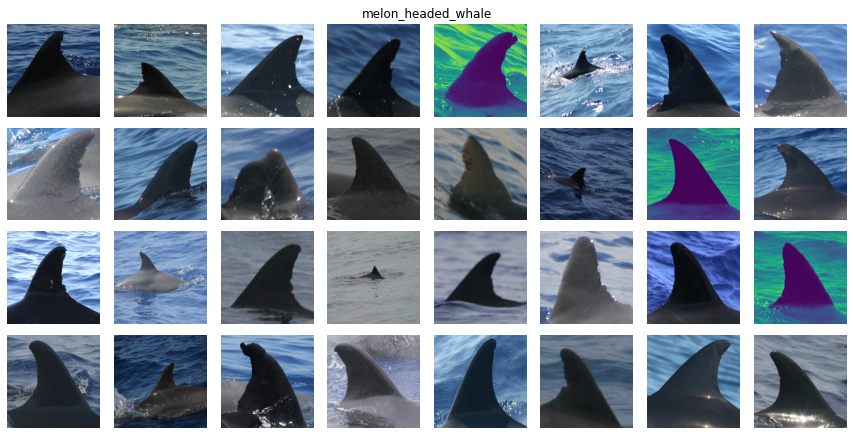

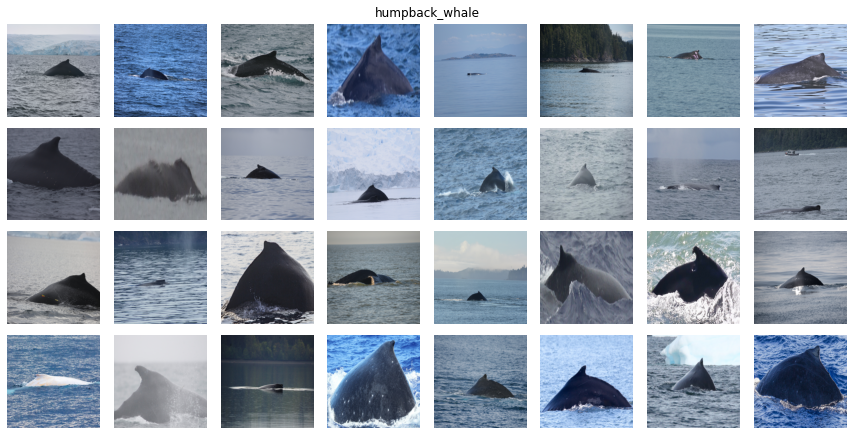

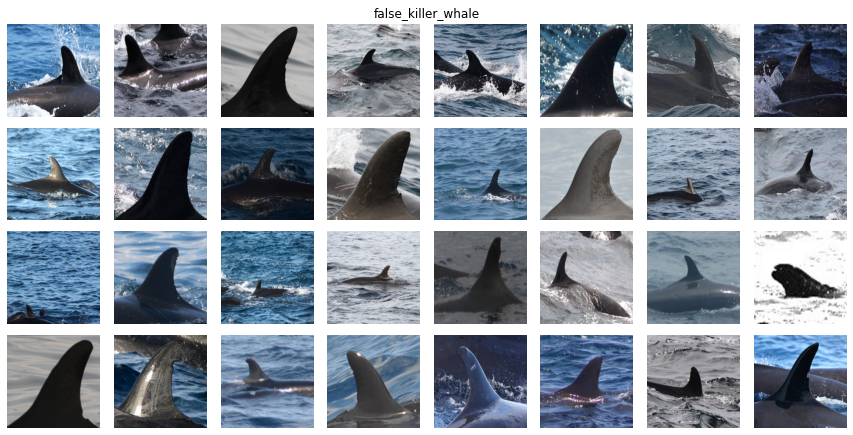

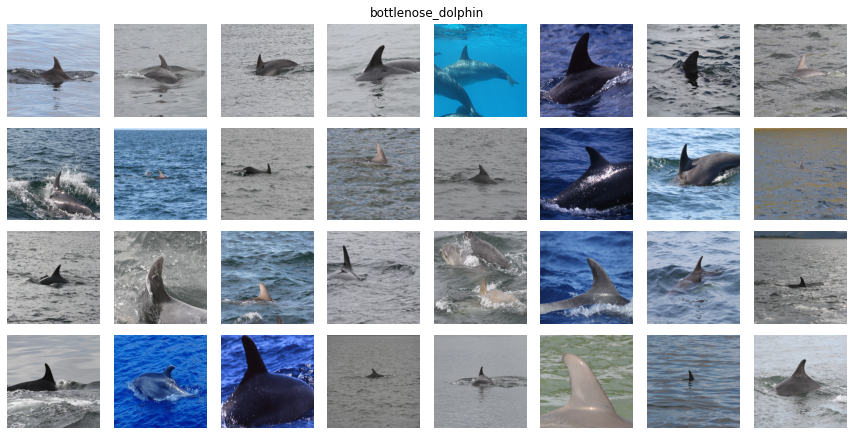

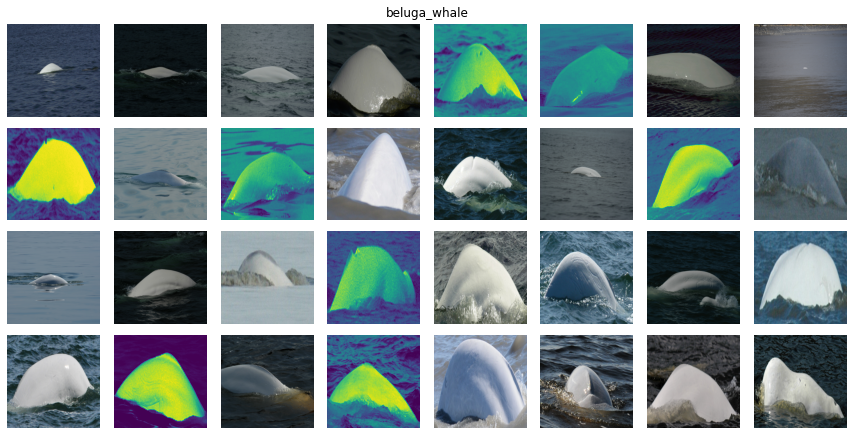

...

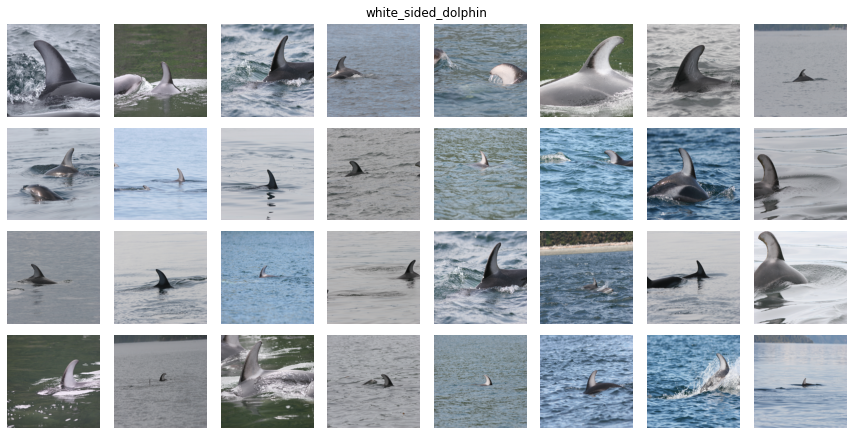

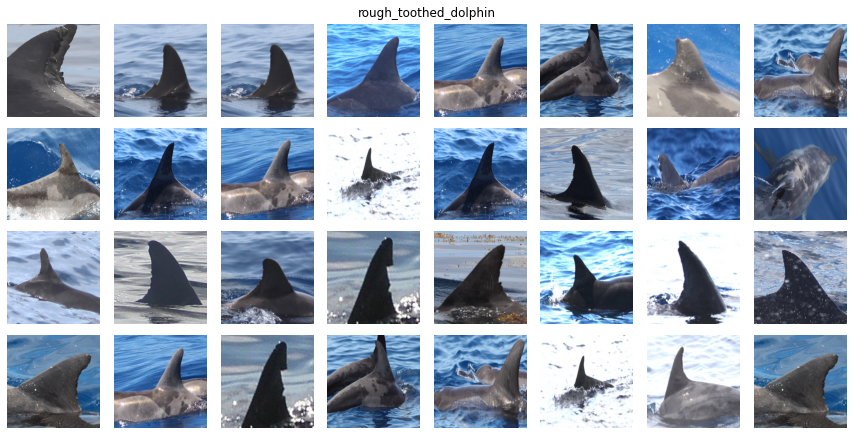

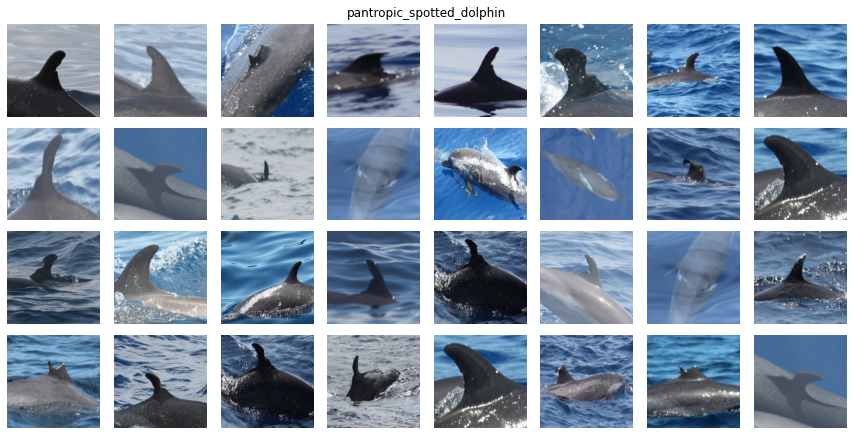

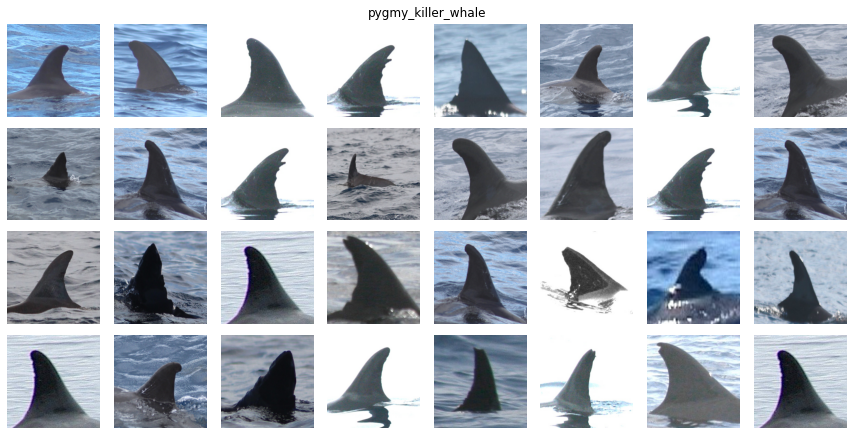

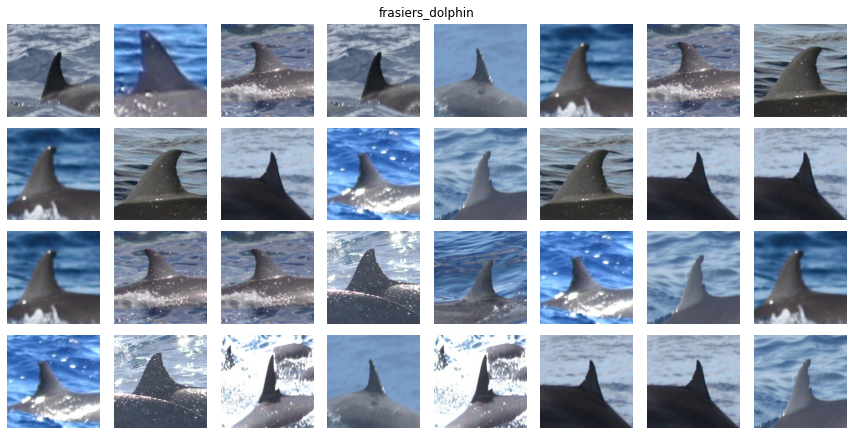

In [40]:
for species in train_df['species'].unique():
    #print('\n\n')
    plot_species(train_df , species)

# image by individual_id

We have to predict individual_id from image.

In [14]:
def plot_individual(df,individual_id):
    plt.figure(figsize = (12,12))
    species_df = df[df['individual_id'] ==individual_id].reset_index(drop = True)
    plt.suptitle(individual_id)
    for idx,i in enumerate(np.random.choice(species_df['path'],24)):
        plt.subplot(8,8,idx+1)
        image_path = i
        img = Image.open(image_path)
        img = img.resize((224,224))
        plt.imshow(img)
        plt.axis('off')
    plt.tight_layout()
    plt.show()

Top 5 most frequent individual


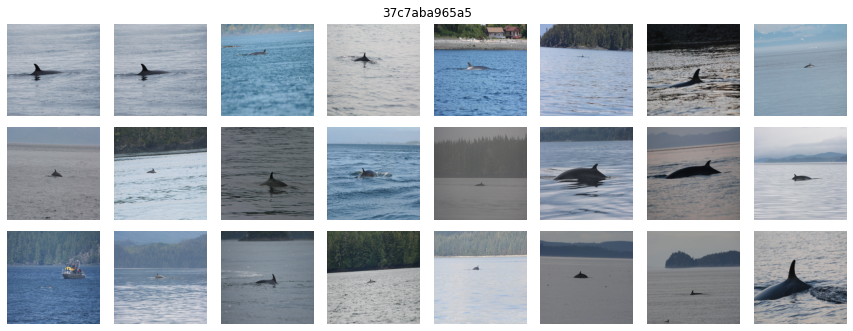

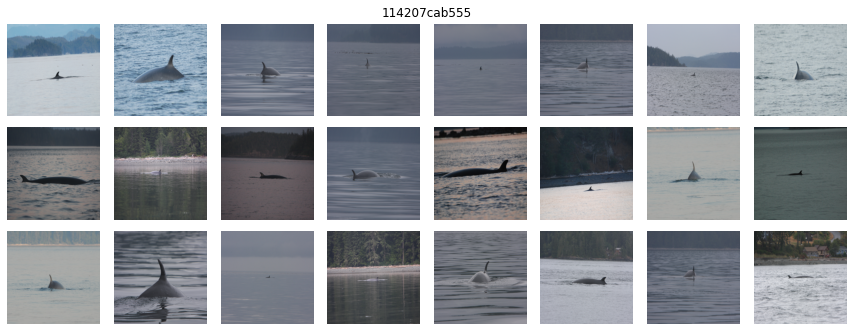

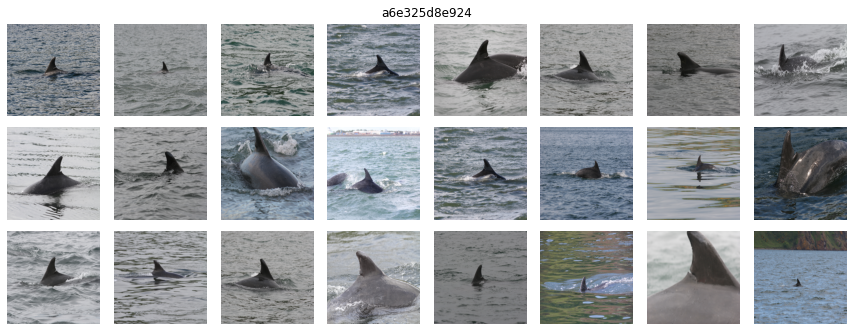

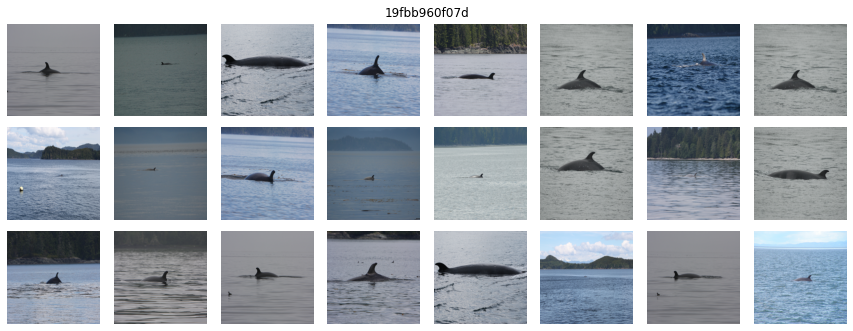

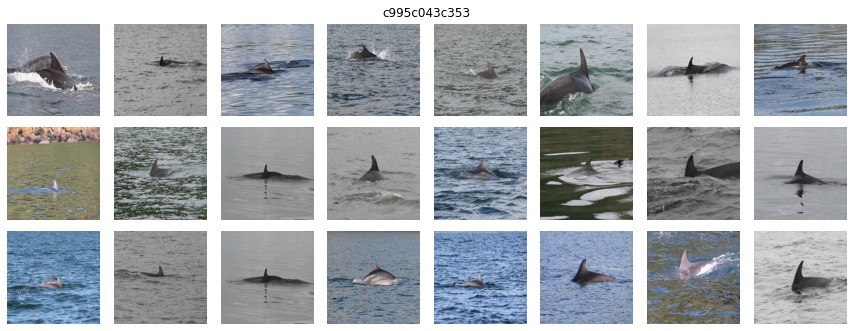

In [43]:
top_5_ids = train_df.individual_id.value_counts().head(5)
for i in top_5_ids.index:
    #print('\n\n')
    plot_individual(train_df , i)

Top 5 least frequent individual


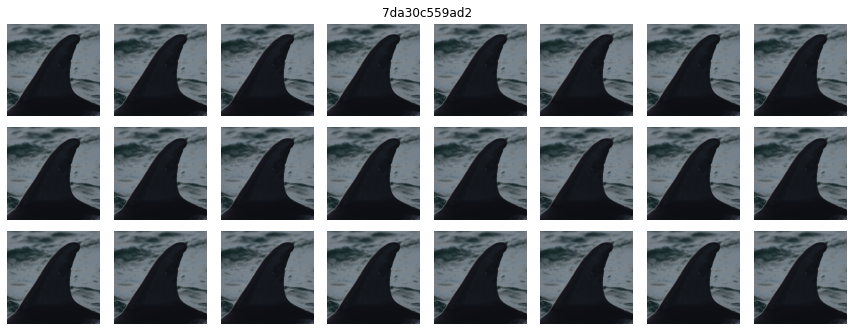

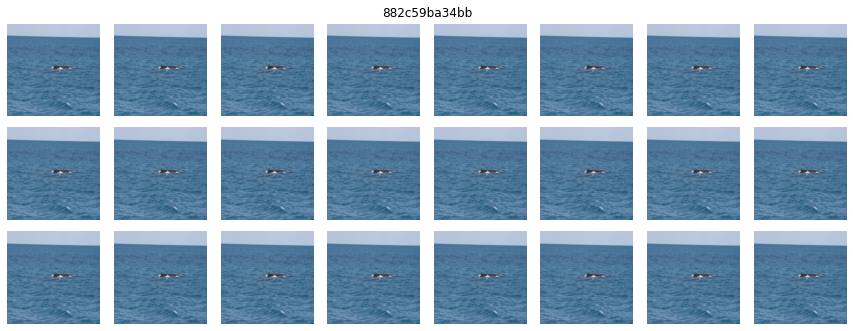

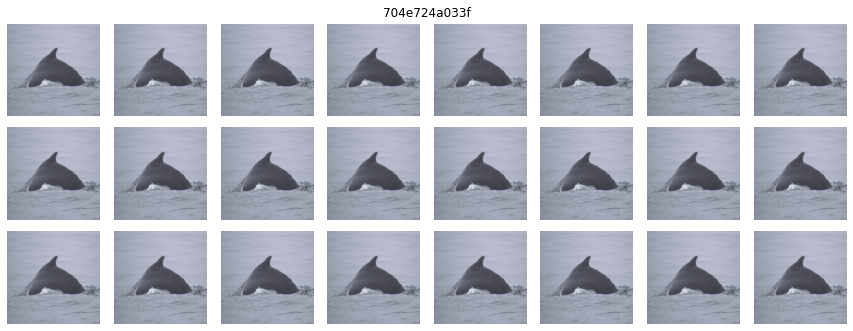

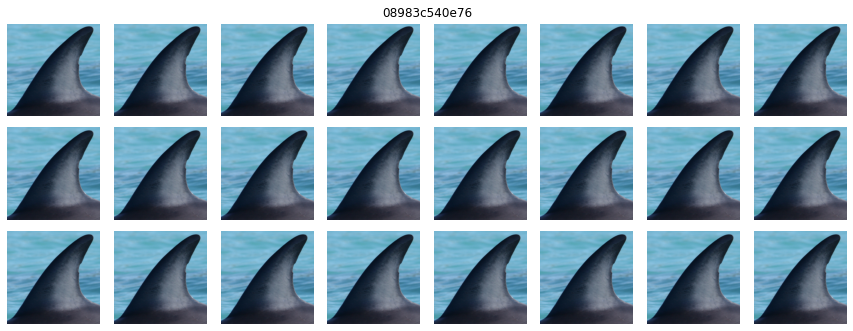

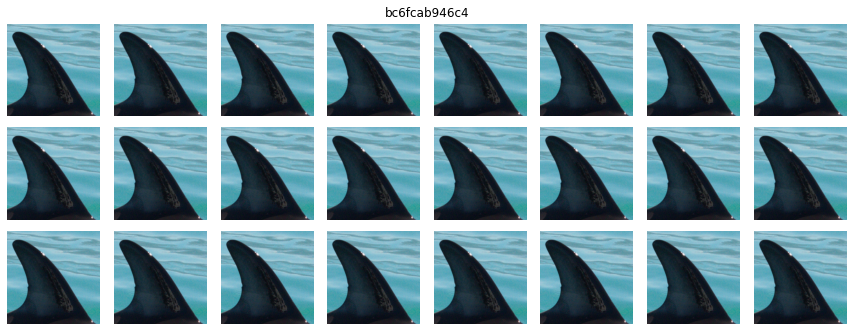

In [44]:
last_5_ids = train_df.individual_id.value_counts().tail(5)
for i in last_5_ids.index:
    #print('\n\n')
    plot_individual(train_df , i)

## Lets see some test images


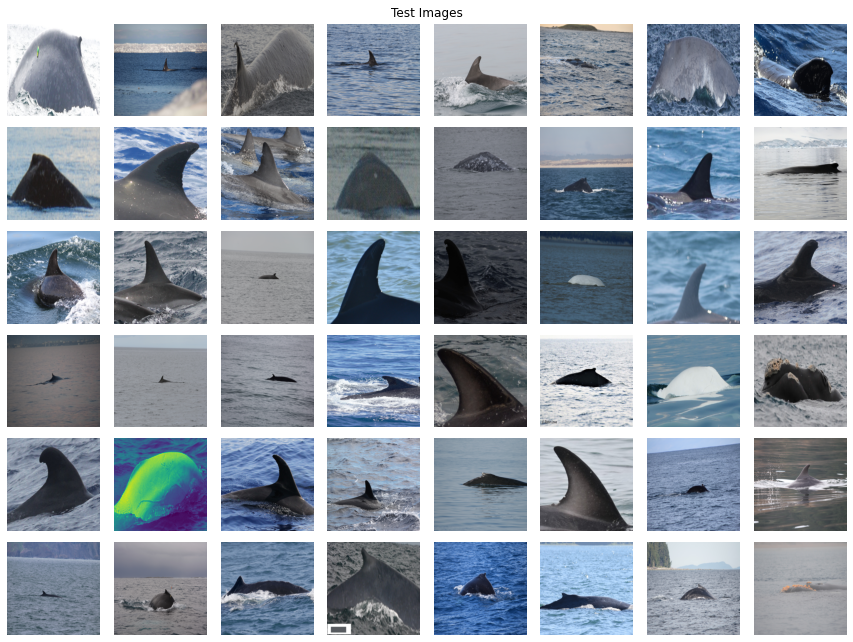

In [15]:
t_df = pd.read_csv('../happy-whale-and-dolphin/sample_submission.csv')
t_df['path'] = '../happy-whale-and-dolphin/test_images/' + t_df['image']

def plot_testimages(df):
    plt.figure(figsize = (12,12))
    plt.suptitle('Test Images')
    for idx,i in enumerate(np.random.choice(df['path'],48)):
        plt.subplot(8,8,idx+1)
        image_path = i
        img = Image.open(image_path)
        img = img.resize((224,224))
        plt.imshow(img)
        plt.axis('off')
    plt.tight_layout()
    plt.show()

plot_testimages(t_df)
del t_df

In [16]:
def plot_sometrainimages(image_ids, rows, cols):
    images = []
    
    plt.figure(figsize = (12,36))
    for idx,i in enumerate(image_ids):
        plt.subplot(rows,cols,idx+1)
        image_path = '../happy-whale-and-dolphin/train_images/' + i
        img = Image.open(image_path)
        img = img.resize((224,224))
        plt.title(i.split('.')[0])
        images.append(i)
        plt.imshow(img)
        plt.axis('off')
    plt.tight_layout()
    plt.show()
    
some_train_images = [
'ba870b9e693201.jpg','7b0fb782fd9288.jpg','b642b895fc7138.jpg','d5a39578f273f3.jpg','6461d14e8348dc.jpg','e8f26d80ec48a2.jpg',
'db9097bd9d8cc1.jpg','5109dfc3b3e104.jpg','13fd25f2e6f344.jpg','7b8a44f8851f07.jpg','5227f5db439364.jpg','a50cd3d93457b1.jpg', 
'381a58bed2fbc1.jpg','1392531bb34c9a.jpg','9867c0f54ff77d.jpg','d4d8ac80cb3a4b.jpg','d3ed54248b6681.jpg','7617259953a75c.jpg',
'186f85fd38a70a.jpg','93e0f73bb86f70.jpg','21b3ad2437152f.jpg','67f0cd56a4a2c5.jpg','3a8c7e5429df52.jpg','e63956125e34b1.jpg',
'd20de23fe239b2.jpg','79be96e5d8674c.jpg','2a6a8d51f1cf49.jpg','5d6ca9ba43d567.jpg','0c03feec795ed0.jpg','061761cee5d501.jpg',
'cc666d76135ec0.jpg','70cad7ea5587d6.jpg','2bff7fb335a178.jpg','f76609dff2c3c6.jpg','090d7f9228a6bc.jpg','58fda080bd639d.jpg',
'1922f6641653d4.jpg','48196cd0f04a9b.jpg','78d7b40e183021.jpg','e7f43942481868.jpg','bb3fd5ca8db073.jpg','13a25d81619913.jpg',
'35d677992a4f2e.jpg','0246806606bc80.jpg','b4fd6577002028.jpg','c0a5ad1aece888.jpg','67ad9cb0769536.jpg','5e1f489ea57e10.jpg',
'63acaed950eab8.jpg','014f6d1c690aff.jpg','097fb940db8b2c.jpg','4edf5f49a062eb.jpg','9a236360f50155.jpg','4fdcfcd6660edd.jpg',
'0b1bd9850ad8a3.jpg','3cfa63a3bbebb7.jpg','31f99c519f55c9.jpg','898559919d173c.jpg','ce7695de81f1fe.jpg','911dd92c244d93.jpg',
'bec33fe0de0384.jpg','5bb81354d55397.jpg','8f8335a84b89fb.jpg','8022b7a61a1f39.jpg','931854aa0b59b6.jpg','07d4d07aa31141.jpg',
'53eca7a79fbf3d.jpg','3d045073aa762d.jpg','cd5fe465c60cb9.jpg','77908aab4bb24b.jpg','abf6f48044116d.jpg','4f43555e842ade.jpg',
'3c15e996c183aa.jpg','726582ee59e000.jpg','9cadc38ade64ac.jpg','402d2e6df3ca51.jpg','05b9a41635a275.jpg','fd7e858f16fb3f.jpg',
'f461e90a1a0909.jpg','5f220b77007ecd.jpg','269a6830d8b3c4.jpg'
]


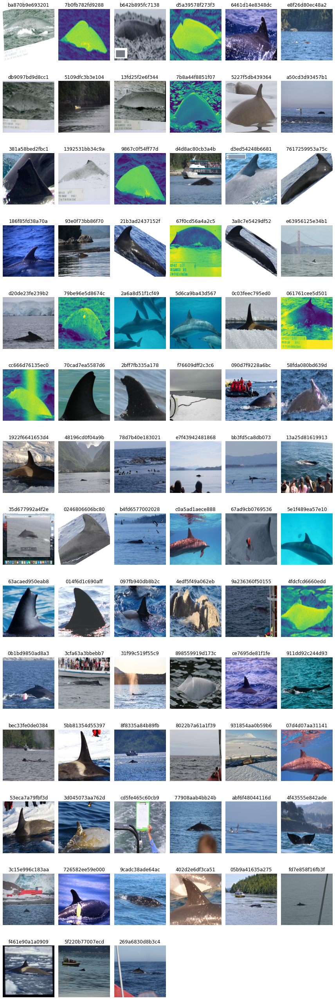

In [17]:
plot_sometrainimages(some_train_images, 14, 6)

In [18]:
def plot_sometestimages(image_ids, rows, cols):
    images = []
    
    plt.figure(figsize = (12,6))
    for idx,i in enumerate(image_ids):
        plt.subplot(rows,cols,idx+1)
        image_path = '../happy-whale-and-dolphin/test_images/' + i
        img = Image.open(image_path)
        img = img.resize((224,224))
        plt.title(i.split('.')[0])
        images.append(i)
        plt.imshow(img)
        plt.axis('off')
    plt.tight_layout()
    plt.show()

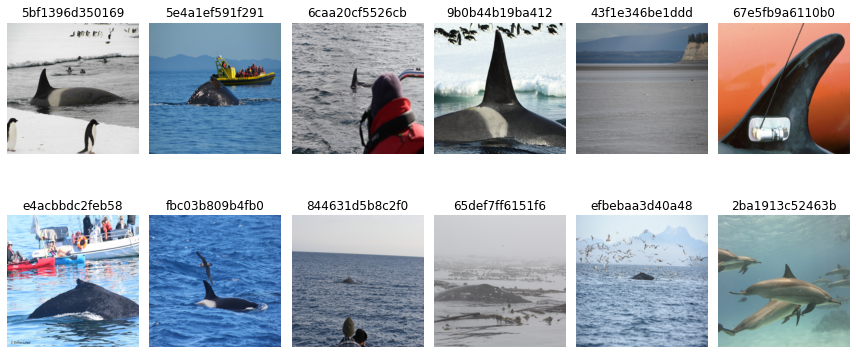

In [19]:
some_test_images = [
'5bf1396d350169.jpg','5e4a1ef591f291.jpg','6caa20cf5526cb.jpg','9b0b44b19ba412.jpg','43f1e346be1ddd.jpg','67e5fb9a6110b0.jpg',
'e4acbbdc2feb58.jpg','fbc03b809b4fb0.jpg','844631d5b8c2f0.jpg','65def7ff6151f6.jpg','efbebaa3d40a48.jpg','2ba1913c52463b.jpg',
]
plot_sometestimages(some_test_images, 2, 6)

# Class Distribution Analysis

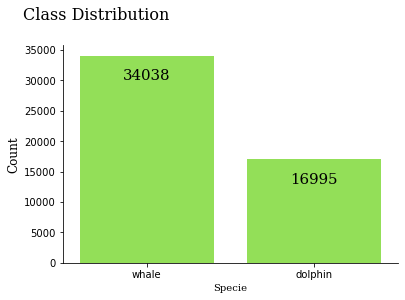

In [13]:
plot = sns.countplot(x = train_df['class'], color = '#90f542')
sns.despine()
plot.set_title('Class Distribution\n', font = 'serif', x = 0.1, y=1, fontsize = 16);
plot.set_ylabel("Count", x = 0.02, font = 'serif', fontsize = 12)
plot.set_xlabel("Specie", fontsize = 12, font = 'serif')

for p in plot.patches:
    plot.annotate(format(p.get_height(), '.0f'), (p.get_x() + p.get_width() / 2, p.get_height()), 
       ha = 'center', va = 'center', xytext = (0, -20),font = 'serif', textcoords = 'offset points', size = 15)

#### Percentage of images of whale and dolphin in the dataset

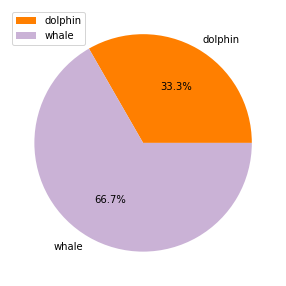

In [14]:
plt.figure(figsize=(5,5))
class_cnt = train_df.groupby(['class']).size().reset_index(name = 'counts')
colors = sns.color_palette('Paired')[7:9]
plt.pie(class_cnt['counts'], labels=class_cnt['class'], colors=colors, autopct='%1.1f%%')
plt.legend(loc='upper left')
plt.show()

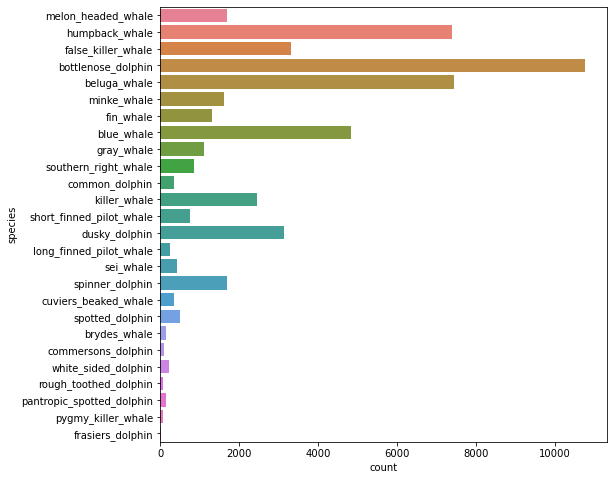

In [15]:
plt.figure(figsize=(8,8))
sns.countplot(data=train_df, y = 'species',  palette='husl', dodge=False)
plt.show()

#### Number of training images of each species of whale and dolphin

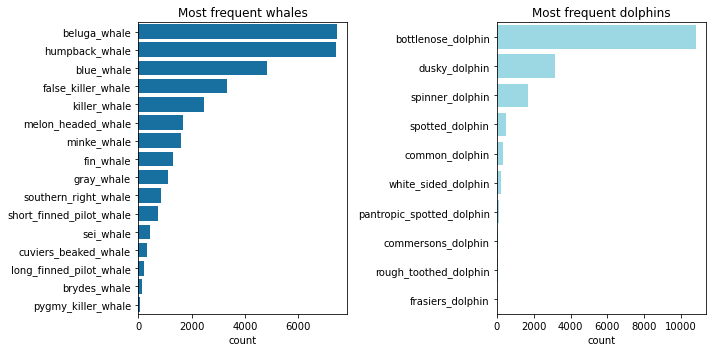

In [23]:
fig,ax = plt.subplots(1,2,figsize=(10,5))

whales = train_df[train_df['class']=='whale']
dolphins = train_df[train_df['class']!='whale']

sns.countplot(y="species", data=whales, order=whales.iloc[0:]["species"].value_counts().index, ax=ax[0], color = "#0077b6")
ax[0].set_title('Most frequent whales')
ax[0].set_ylabel(None)
    
sns.countplot(y="species", data=dolphins,order=dolphins.iloc[0:]["species"].value_counts().index, ax=ax[1], color = "#90e0ef")
ax[1].set_title('Most frequent dolphins')
ax[1].set_ylabel(None)

plt.tight_layout()
plt.show()

##### Number of training images of top 10 individuals

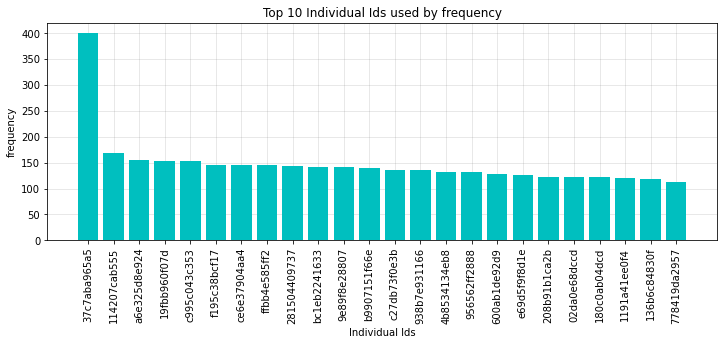

In [24]:
plt.figure(figsize=(12,4))
top_ten_ids = train_df.individual_id.value_counts().head(24)
top_ten_ids = pd.DataFrame({'individual_id':top_ten_ids.index, 'frequency':top_ten_ids.values})

plt.bar(top_ten_ids['individual_id'],top_ten_ids['frequency'],width = 0.8,color='c',zorder=4)
plt.xticks(rotation=90)
plt.ylabel("frequency")
plt.xlabel("Individual Ids")
plt.title("Top 10 Individual Ids used by frequency")
plt.grid(visible = True, color ='grey',linestyle ='-', linewidth = 0.9,alpha = 0.2, zorder=0)
plt.show()

#### Plot the value count graph of each individual


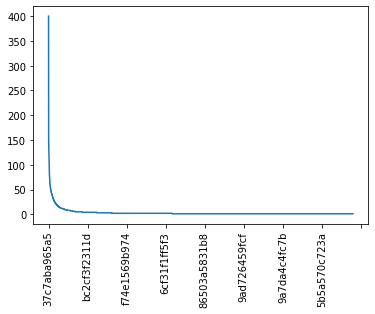

In [25]:
train_df['individual_id'].value_counts().plot()
plt.xticks(rotation=90)
plt.show()

##### Density estimation of each individuals

<AxesSubplot:ylabel='Density'>

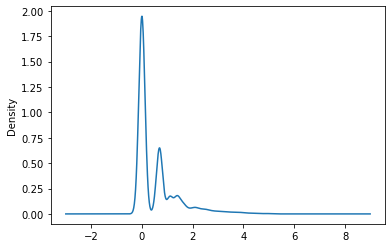

In [26]:
np.log(train_df['individual_id'].value_counts()).plot.kde()

#### Density estimation of individual by whale and dolphin

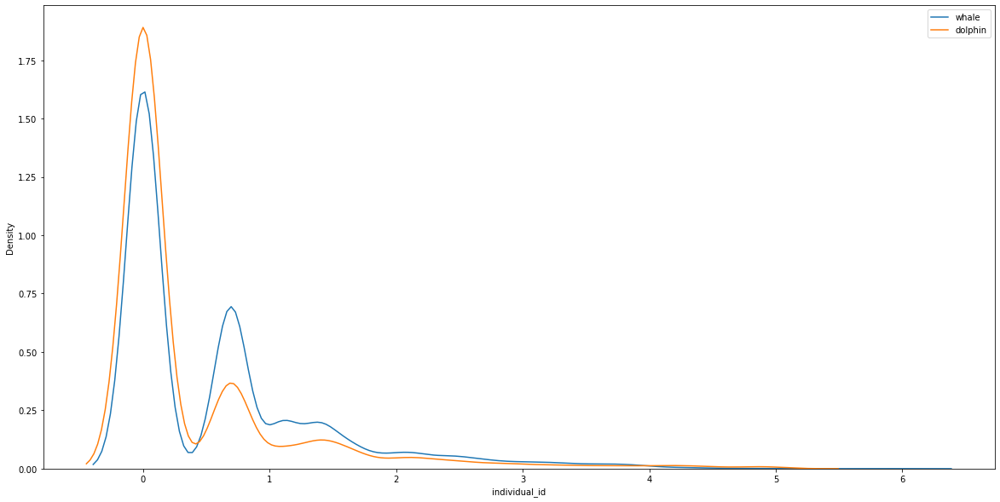

In [27]:
plt.figure(figsize = (20, 10))
sns.kdeplot(np.log(train_df.loc[train_df['class'] == 'whale']['individual_id'].value_counts()))
sns.kdeplot(np.log(train_df.loc[train_df['class'] == 'dolphin']['individual_id'].value_counts()))
plt.legend(labels = ['whale', 'dolphin'])
plt.show()

In [28]:
#### Number of unique individuals in the dataset
len(train_df.individual_id.unique())

15587

In [29]:
train_df.head()

,image,species,individual_id,path,class
0,00021adfb725ed.jpg,melon_headed_whale,cadddb1636b9,../happy-whale-and-dolphin/train_images/00021a...,whale
1,000562241d384d.jpg,humpback_whale,1a71fbb72250,../happy-whale-and-dolphin/train_images/000562...,whale
2,0007c33415ce37.jpg,false_killer_whale,60008f293a2b,../happy-whale-and-dolphin/train_images/0007c3...,whale
3,0007d9bca26a99.jpg,bottlenose_dolphin,4b00fe572063,../happy-whale-and-dolphin/train_images/0007d9...,dolphin
4,00087baf5cef7a.jpg,humpback_whale,8e5253662392,../happy-whale-and-dolphin/train_images/00087b...,whale


## Image count of individuals

In [36]:
train_df['count'] = train_df.groupby('individual_id',as_index=False)['individual_id'].transform(lambda x: x.count())

In [37]:
train_df.head()

,image,species,individual_id,path,class,count
0,00021adfb725ed.jpg,melon_headed_whale,cadddb1636b9,../happy-whale-and-dolphin/train_images/00021a...,whale,1
1,000562241d384d.jpg,humpback_whale,1a71fbb72250,../happy-whale-and-dolphin/train_images/000562...,whale,2
2,0007c33415ce37.jpg,false_killer_whale,60008f293a2b,../happy-whale-and-dolphin/train_images/0007c3...,whale,64
3,0007d9bca26a99.jpg,bottlenose_dolphin,4b00fe572063,../happy-whale-and-dolphin/train_images/0007d9...,dolphin,65
4,00087baf5cef7a.jpg,humpback_whale,8e5253662392,../happy-whale-and-dolphin/train_images/00087b...,whale,50


## Individuals with only one training image

In [38]:
train_df[train_df['count']==1]

,image,species,individual_id,path,class,count
0,00021adfb725ed.jpg,melon_headed_whale,cadddb1636b9,../happy-whale-and-dolphin/train_images/00021a...,whale,1
16,0018064338b499.jpg,blue_whale,4790ec346170,../happy-whale-and-dolphin/train_images/001806...,whale,1
17,001b0900f56e89.jpg,humpback_whale,bc14b5054353,../happy-whale-and-dolphin/train_images/001b09...,whale,1
26,002618d6f63ebc.jpg,southern_right_whale,f5eab86405b4,../happy-whale-and-dolphin/train_images/002618...,whale,1
28,0029d877c29ab4.jpg,melon_headed_whale,c27f0a7f4e5a,../happy-whale-and-dolphin/train_images/0029d8...,whale,1
...,...,...,...,...,...,...
50988,ffbe97e98dc414.jpg,dusky_dolphin,dc6005ba4d2b,../happy-whale-and-dolphin/train_images/ffbe97...,dolphin,1
51003,ffd233d91c41c7.jpg,dusky_dolphin,4de77853688d,../happy-whale-and-dolphin/train_images/ffd233...,dolphin,1
51005,ffda27396b72d3.jpg,melon_headed_whale,3509cb6a8504,../happy-whale-and-dolphin/train_images/ffda27...,whale,1
51012,ffe2cfd8177062.jpg,short_finned_pilot_whale,e880e47c06a4,../happy-whale-and-dolphin/train_images/ffe2cf...,whale,1


<li>Total Number of individuals are 15587

<li>9258 individuals have just one image

## Image Resolutions¶


In [39]:
widths, heights = [], []

for path in tqdm(train_df["path"]):
    width, height = Image.open(path).size
    widths.append(width)
    heights.append(height)
    
train_df["width"] = widths
train_df["height"] = heights
train_df["dimension"] = train_df["width"] * train_df["height"]

100%|███████████████████████████████████| 51033/51033 [00:15<00:00, 3355.23it/s]


## Lets see some small images

In [40]:
train_df.sort_values('width').head(84)

,image,species,individual_id,path,class,count,width,height,dimension
15347,4d817d2f3e6298.jpg,frasiers_dolphin,3a44ec1f15be,../happy-whale-and-dolphin/train_images/4d817d...,dolphin,1,75,68,5100
18465,5d16c97384a770.jpg,dusky_dolphin,31f407418252,../happy-whale-and-dolphin/train_images/5d16c9...,dolphin,1,82,100,8200
4755,17ba96a999c021.jpg,dusky_dolphin,9e2d4c30cad3,../happy-whale-and-dolphin/train_images/17ba96...,dolphin,1,82,70,5740
40361,cb149230800773.jpg,dusky_dolphin,7ba33c4c1c86,../happy-whale-and-dolphin/train_images/cb1492...,dolphin,1,82,106,8692
3917,13b99d83b604f4.jpg,pygmy_killer_whale,8931907b6c63,../happy-whale-and-dolphin/train_images/13b99d...,whale,1,88,75,6600
...,...,...,...,...,...,...,...,...,...
15176,4c9c253630a8f2.jpg,dusky_dolphin,bac6c9351f38,../happy-whale-and-dolphin/train_images/4c9c25...,dolphin,2,156,168,26208
50246,fc01a5e6b696db.jpg,dusky_dolphin,66bcd305cb30,../happy-whale-and-dolphin/train_images/fc01a5...,dolphin,1,158,144,22752
4232,151d9c6bea3d29.jpg,dusky_dolphin,78edb1b29a87,../happy-whale-and-dolphin/train_images/151d9c...,dolphin,2,158,204,32232
19820,63f470cf38c235.jpg,dusky_dolphin,e1e84bba00f3,../happy-whale-and-dolphin/train_images/63f470...,dolphin,1,159,186,29574
